# Fall 2023 | COM110 | Final Project
## Visualization of Different Time-Series Data in the COVID-19 Pandemic
### Derin Gezgin, Alec Blevins, Arjun Premkumar

In [1]:
### Import Statements ###
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from scipy.signal import find_peaks
import plotly.express as px
import country_converter

# Part 1: Stocks Data in COVID-19
## A) Data Exploration and Basic Plotting
In this part, we downloaded stock data in .csv format from Yahoo Finance.

We downloaded data from January 1st, 2021, and January 1st, 2023.
We downloaded stock data for six companies.
1. Microsoft (MSFT)
2. Moderna (MRNA)
3. Tesla (TSLA)
4. PFE (Pfizer)
5. Zoom (ZM)
6. Apple (AAPL)
    
We first declared several functions for reading the data, converting it, and plotting them for first impressions.

In [2]:
def read_data(path, d="Date"):
    """Function that takes a file path for a csv file as an input creates a Pandas dataframe with the file and converts the date column into a datetime object."""
    df = pd.read_csv(path, header=0)
    df[d] = pd.to_datetime(df[d]) # Converting Column
    return df

def get_title(path):
    """Function to return the name of the file by scraping it from the file path"""
    return os.path.basename(path)[:-4]

def roller(column, n):
    """Roller function to smooth the time-series data. Takes input the column to work with and also the smoothing interval. Returns the rolled column."""
    return column.rolling(window=n).mean()

def plotter(df, column, main_title, date_column, y_title, rolling=1):
    """Function to plot the given dataframe or plot multiple dataframes (from a dictionary)"""
    plt.style.use("dark_background")
    plt.figure(figsize=(16,9))
    plt.xticks(fontsize=14, rotation=315)
    plt.yticks(fontsize=14)
    plt.title(main_title, fontsize=18)
    plt.xlabel("Date", fontsize=14)
    plt.ylabel(y_title, fontsize=14)
    
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))
    plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=4))
    plt.gca().xaxis.set_minor_locator(mdates.MonthLocator())
    
    if type(df) == dict:
        for title in df: plt.plot(df[title][date_column], roller(df[title][column],rolling), label=title)
        plt.legend(fontsize=16)
    else: plt.plot(df[date_column], roller(df[column], rolling))

In [3]:
csv_files = glob.glob("data/csv_stock_data/*.csv") # Storing every file name in the csv_stock_data folder in a list

stock_dfs = [read_data(file) for file in csv_files] # Reading the files and creating a dataframe
titles = [get_title(file) for file in csv_files] # Reading the file names and storing them in a list
df_dict = {title:stock for (title,stock) in zip(titles, stock_dfs)} # Merging the values in a dictionary

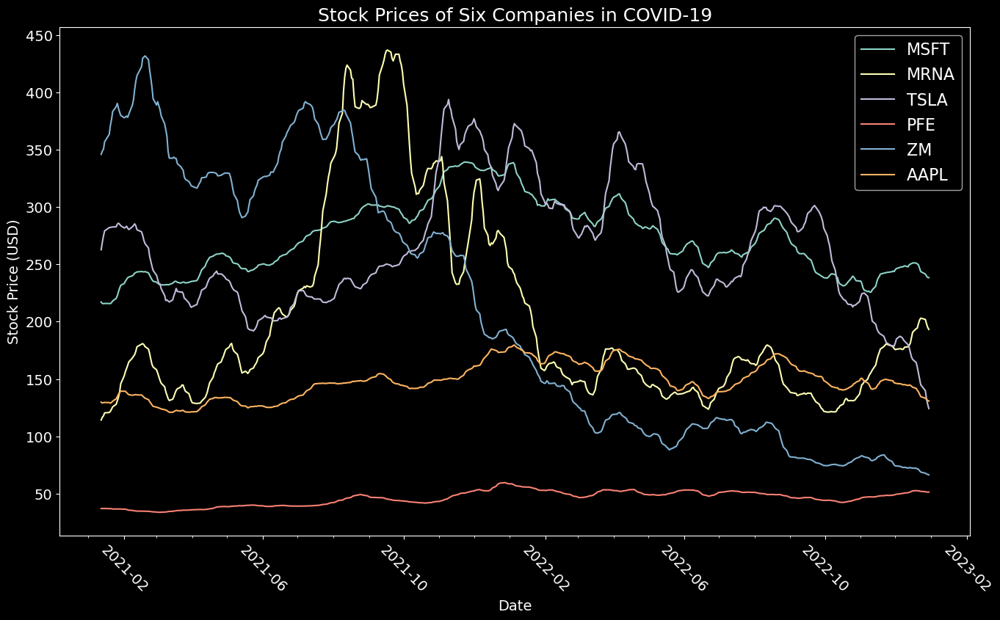

In [4]:
# # Plotting the dataframes one by one in separate plots. # Commented to reduce runtime. You can uncomment to see individual plots.
# for title in df_dict:
#     s = df_dict[title]
#     plotter(df=s,
#             column="Open",
#             main_title=title,
#             date_column="Date",
#             y_title="Stock Price (USD)")

# Plotting all in the same plot.
plotter(df=df_dict,
        column="Open",
        date_column="Date",
        y_title="Stock Price (USD)",
        main_title="Stock Prices of Six Companies in COVID-19",
        rolling=7)

## B) Using Proportions
The problem we faced here is that stock prices can be in different price ranges, and it's not very easy to see their similarities with such plotting. So, we created another column in the files called Proportion. We calculated the proportion of the Opening Price for every day with the first day to find the proportional change in the prices. This helped us to see the change in stock prices more easily.

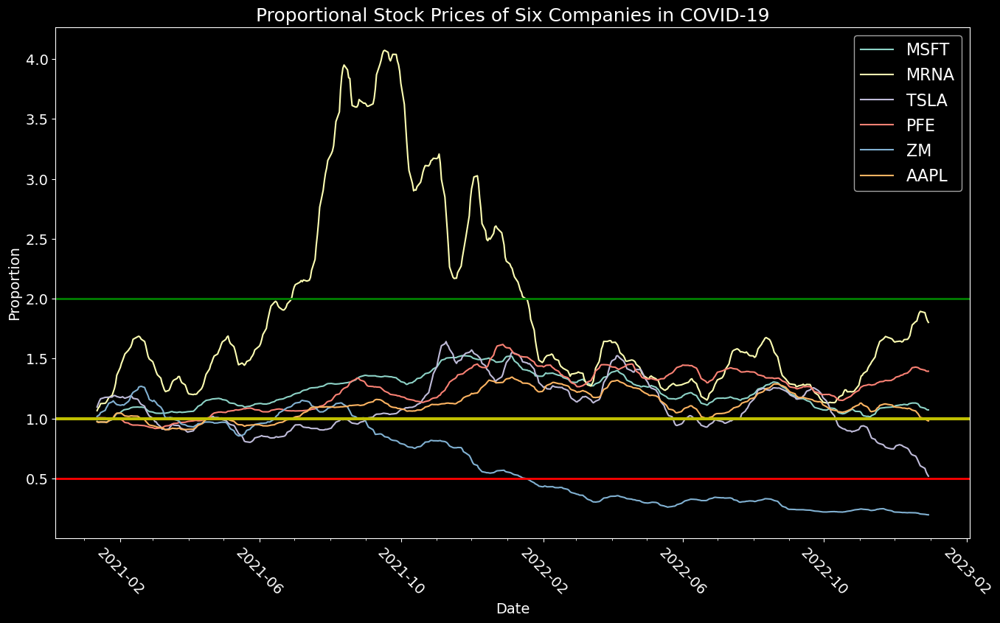

In [5]:
def proportion_calc(df, column):
    """Function that calculates the ratio of the whole column with the first column value and saves it in a new column called Proportion."""
    proportion_column = df[column] / df[column].iloc[0]
    df["Proportion"] = proportion_column

# Using the new function and plotting it with the plotter function
for item in list(df_dict.items()): proportion_calc(item[1], "Open")
plotter(df=df_dict,
        column="Proportion",
        date_column="Date",
        y_title="Proportion",
        main_title="Proportional Stock Prices of Six Companies in COVID-19",
        rolling=7)

# Adding lines in y=1 (no change), y=2 (double), y=0.5 (half)
plt.axhline(y=1, color="y", linestyle="-", linewidth=3)
plt.axhline(y=2, color="g", linestyle="-", linewidth=2)
plt.axhline(y=0.5, color="r", linestyle="-", linewidth=2)

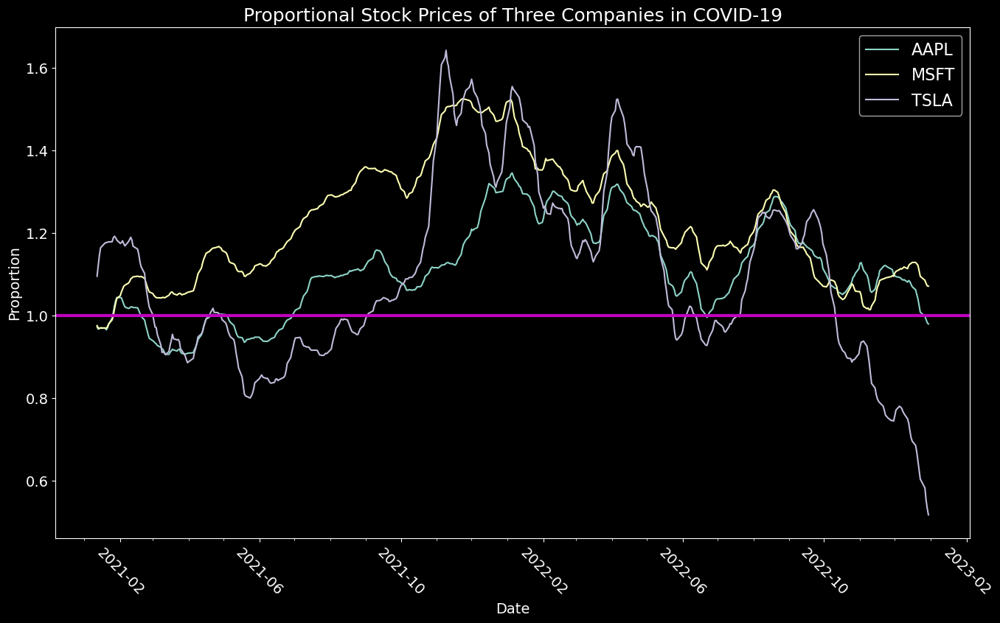

In [6]:
# Plotting only more stable stocks to see the changes in them more closely.
keys = ["AAPL", "MSFT", "TSLA"]
tech_df_dict = {key: df_dict[key] for key in keys}

plotter(df=tech_df_dict,
        column="Proportion",
        date_column="Date",
        y_title="Proportion",
        main_title="Proportional Stock Prices of Three Companies in COVID-19",
        rolling=7)

# Adding line y=1 for easier comparing to the initial values.
plt.axhline(y=1, color="m", linestyle="-", linewidth=3)

## C) Our Conclusions After These Results
The result that we had after plotting both the original and the proportionate stock prices is somewhat different from what we expected.
1. We first expected the stock price of the communications software company Zoom would skyrocket during the COVID-19 pandemic due to the nature of its online usage. We found in the proportional graph that Zoom's stock price lost more than half its value in the observed time frame.
2. We expected a significant increase in the stock prices for the health companies Moderna and Pfizer. As predicted, Moderna's stock price increased significantly throughout the middle of the pandemic. It peaked at 2021–10 with x4 of its original value, but this shortly returned to the original value in 2022-06. It closed the period with nearly double its initial price.
3. On the other hand, the stock price of Pfizer was stable throughout the given time frame. It showed a x1.5 increase at the end of the period. Out of all six stocks, Pfizer remained the most stable. 
4. Microsoft, Apple, and Tesla showed similar performances (synchronous peaks, symmetrical movements, etc.) throughout the observed period. However, an exception can be seen after the 2022-10 mark, when Tesla stocks significantly dropped contrary to the others.

# Part 2: Crypto-Asset Data in COVID-19
## A) Data Exploration and Plotting
In the second part of our project, we looked at the values of five different crypto assets.
1. USDT-USD (Tether)
2. ETH-USD (Ethereum)
3. BTC-USD (Bitcoin)
4. XRP-USD (Ripple)
5. BNB-USD (Binance Coin)

We plotted all of them one by one to see the individual plots. After this, we plotted them in the same graph (with plotter) by also applying the proportion_calc in order to see the proportional relationships between them

In [7]:
csv_files = glob.glob("data/csv_crypto_data/*.csv") # Storing every file name in the csv_stock_data folder in a list

stock_dfs = [read_data(file) for file in csv_files] # Reading the files and creating a dataframe
titles = [get_title(file) for file in csv_files] # Reading the file names and storing them in a list
df_dict = {title:stock for (title,stock) in zip(titles, stock_dfs)} # Merging the values in a dictionary

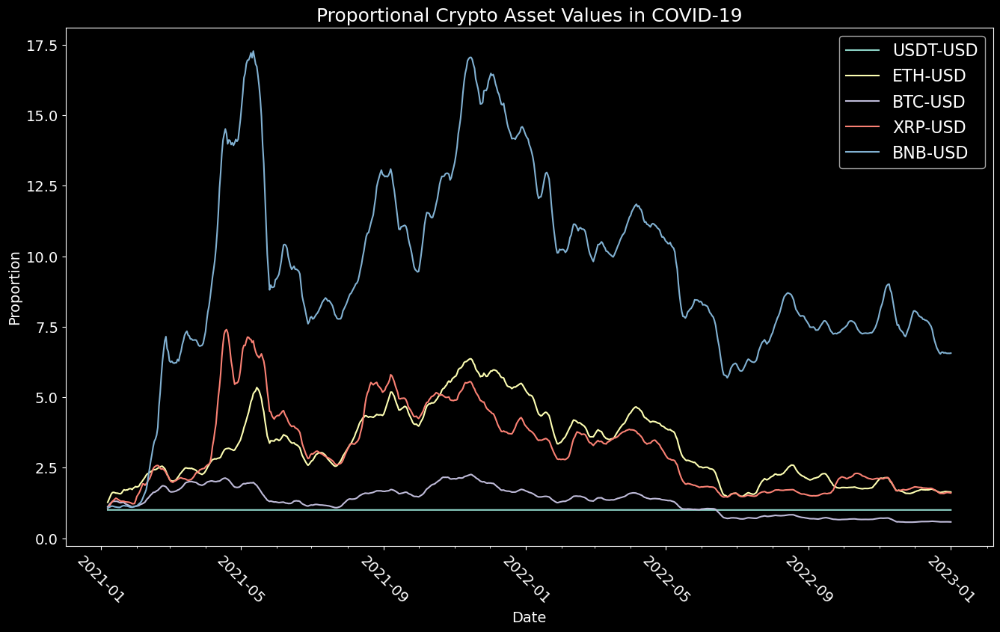

In [8]:
# # Plotting the dataframes one by one in separate plots. # Commented to reduce runtime. You can uncomment to see individual plots.
# for title in df_dict:
#     s = df_dict[title]
#     plotter(df=s,
#             column="Open",
#             main_title=title,
#             date_column="Date",
#             y_title="Crypto Price (USD)")

# Plotting the proportional value of every crypto-asset in the same graph.
for item in list(df_dict.items()): proportion_calc(item[1], "Open")
plotter(df=df_dict,
        column="Proportion",
        date_column="Date",
        y_title="Proportion",
        main_title="Proportional Crypto Asset Values in COVID-19",
        rolling=7)

## B) Highlighting the Peaks and Finding Similarities
When we plotted all the stock data in the same graph, we can see some similarities in the peaks. To examine this further, we wrote a function highlighting the peaks in all the data frames and plotted them in the same graph to see the similarities.

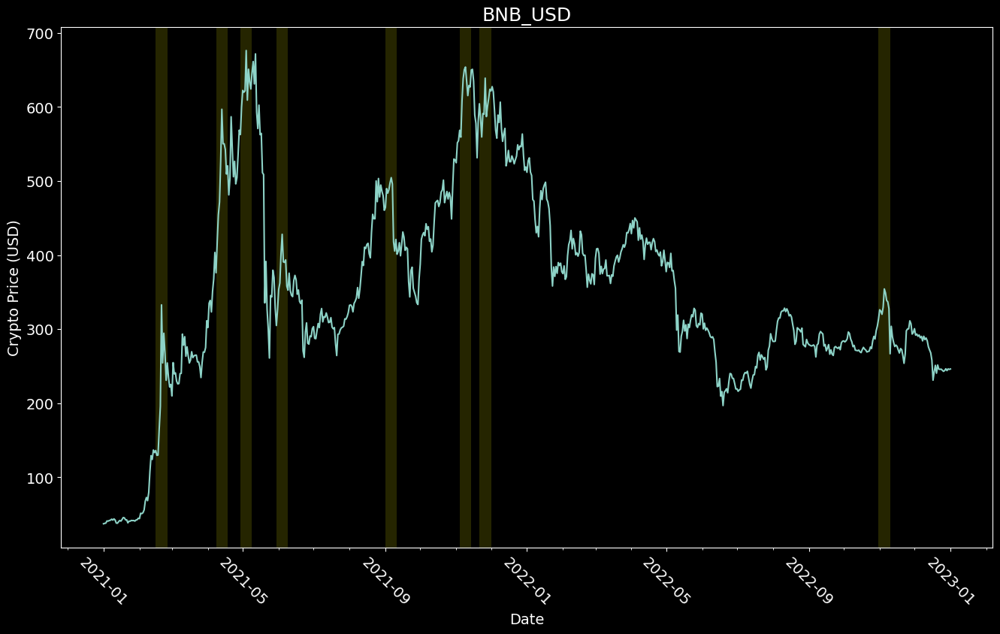

In [9]:
def peak_finder(df, column, p):
    """Function to find the peak values in a dataframe and highlights the -3/+3 days from that date."""
    data = df[column]
    peaks = find_peaks(data, prominence=p)[0]
    for peak in peaks: plt.axvspan(df["Date"].iloc[peak-5], df["Date"].iloc[peak+5], facecolor="yellow", alpha=0.15)

# Sample usage of the peak_finder with the BNB_USD file
s = df_dict["BNB-USD"]
plotter(df=s,
        column="Open", 
        main_title="BNB_USD",
        date_column="Date",
        y_title="Crypto Price (USD)")
peak_finder(s, "Open", 100)

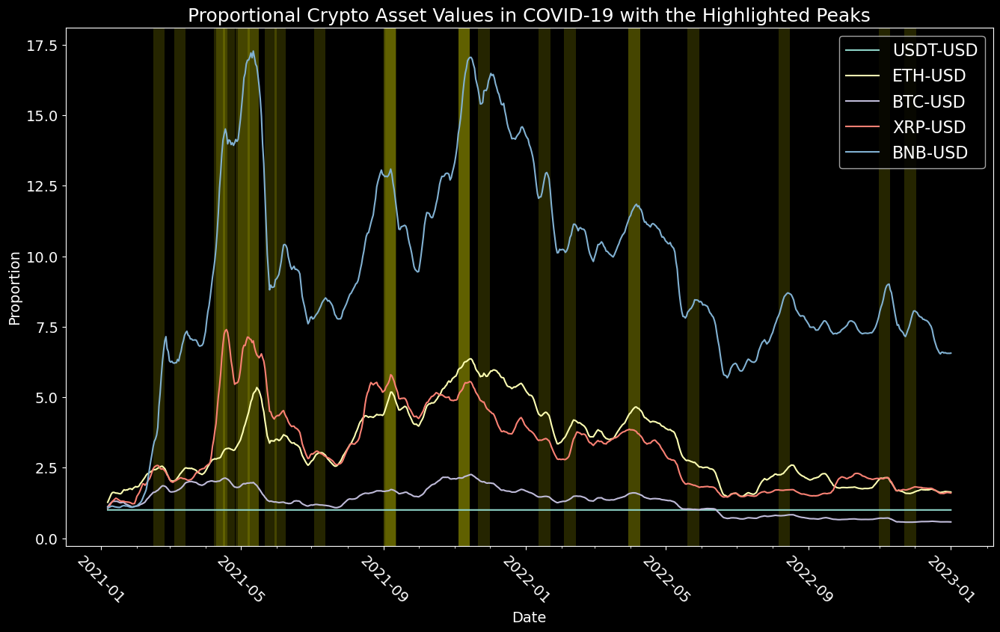

In [10]:
# Plotting all the stock data again
plotter(df=df_dict,
        column="Proportion",
        date_column="Date",
        y_title="Proportion",
        main_title="Proportional Crypto Asset Values in COVID-19 with the Highlighted Peaks",
        rolling=7)

# Applying the peak_finder function to all the dataframes in the plot. 
for item in list(df_dict.items()): peak_finder(item[1], "Proportion", 1.5)

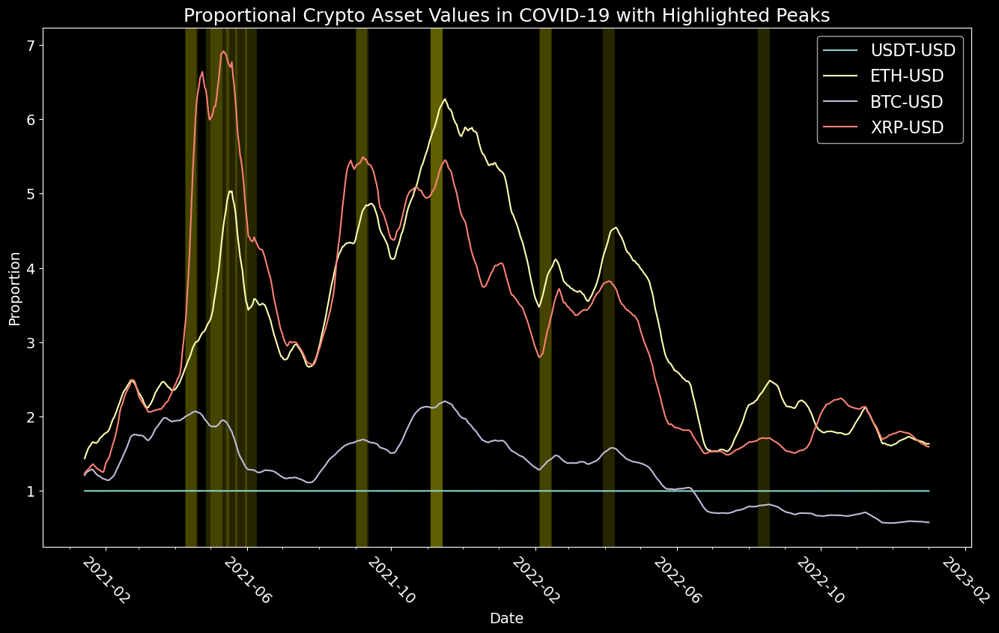

In [11]:
# Plotting the crypto assets other than Binance Coin to see the differences in them more closely. 
keys = [key for key in df_dict if key != "BNB-USD"]
stable_df_dict = {key: df_dict[key] for key in keys}
plotter(df=stable_df_dict,
        column="Proportion",
        date_column="Date",
        y_title="Proportion",
        main_title="Proportional Crypto Asset Values in COVID-19 with Highlighted Peaks",
        rolling=14)

for item in list(stable_df_dict.items()): peak_finder(item[1], "Proportion", 1.0)

## C) Our Conclusions After These Results
When we plotted all the crypto asset prices using the peak_finder function, we noticed similarities in the peaks of the different crypto-asset values.
Because the peak_finder function highlights the peaks in the time-series data, the color in the plot becomes less transparent when multiple peaks happen simultaneously in different crypto-assets. Considering this and the proportional plot, we reached the following conclusions:
1. When we examine the graph, we see more solid highlighted time points, especially in 2021–09 and 2021–11.
2. We can see that the peaks in most of the assets (except BTC and USDT) happen at similar periods. This suggests asynchronous movement between the assets. 
3. From the graph, we can infer that ROI-wise, Binance Coin (BNB) was the most profitable with nearly x7.5. 
4. At the end of the period, Bitcoin closed with a loss.
5. We can see that the stable-coin, "USDT-USD," didn't fluctuate throughout the period and acted as a y=1 line in the graph. 

# Part 3: Geographical Case Data
## A) Data Exploration and Basic Plotting
In this part, we downloaded case data from the start to the end of COVID-19 from the WHO website.

In [12]:
health_data = read_data("data/covid_19_data.csv", d="Date_reported")

## B) Filtering Data & Plotting
After we read the case data from the .csv file, printed its shape, and sampled a random sample, we can see that the dataset has eight columns and 336540 rows, including the title row. 
The dataset presents the case data as country-based and region-based. First, we must filter the data and create a new dictionary with separate regions and related data. 

In [13]:
regions = list(health_data.WHO_region.unique()) # Unique region codes in the dataframe stored in a list

# Filtering values and creating a new dictionary with region names as a key and the region-specific values as a dataframe
regions_dict = {r:health_data[health_data.WHO_region == r] for r in regions}

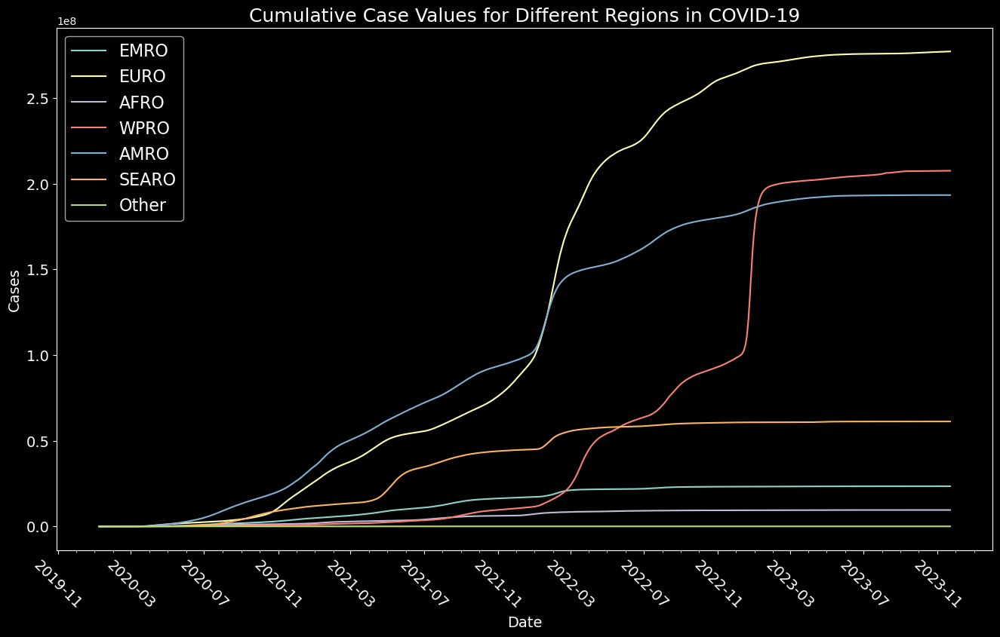

In [14]:
# Finding the sum of cumulative cases for each day and region.
daily_case_sums = {k:v.groupby("Date_reported")["Cumulative_cases"].sum().reset_index() for k,v in regions_dict.items()}

# # Commented to reduce runtime. You can uncomment to see individual plots.
# for region in daily_case_sums:
#     daily_df = daily_case_sums[region]
#     plotter(df=daily_df,
#             column="Cumulative_cases",
#             main_title=region,
#             date_column="Date_reported",
#             y_title="Cases")

# Plotting the cumulative sum of cases.
plotter(df=daily_case_sums,
        column="Cumulative_cases",
        date_column="Date_reported",
        y_title="Cases",
        main_title="Cumulative Case Values for Different Regions in COVID-19",
        rolling=7)

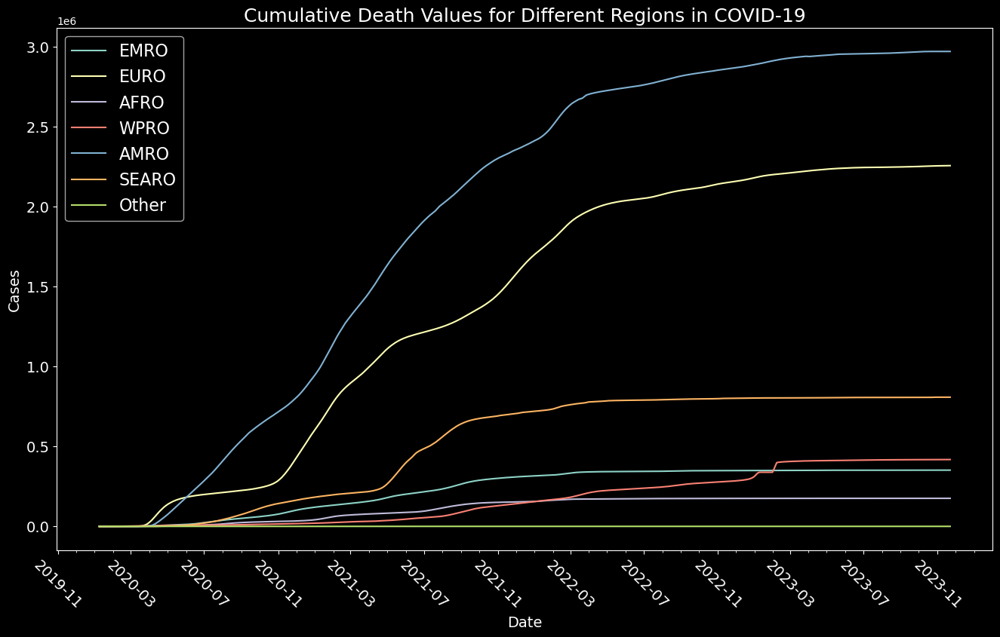

In [15]:
# Finding the sum of cumulative deaths for each day and region.
daily_death_sums = {k:v.groupby("Date_reported")["Cumulative_deaths"].sum().reset_index() for k,v in regions_dict.items()}

# # Plotting the daily deaths in individual # Commented to reduce runtime. You can uncomment to see individual plots.
# for region in daily_death_sums:
#     daily_df = daily_death_sums[region]
#     plotter(df=daily_df,
#             column="Cumulative_deaths",
#             main_title=region,
#             date_column="Date_reported",
#             y_title="Cases")

# Plotting the cumulative sum of deaths.
plotter(df=daily_death_sums,
        column="Cumulative_deaths",
        date_column="Date_reported",
        y_title="Cases",
        main_title="Cumulative Death Values for Different Regions in COVID-19",
        rolling=7)

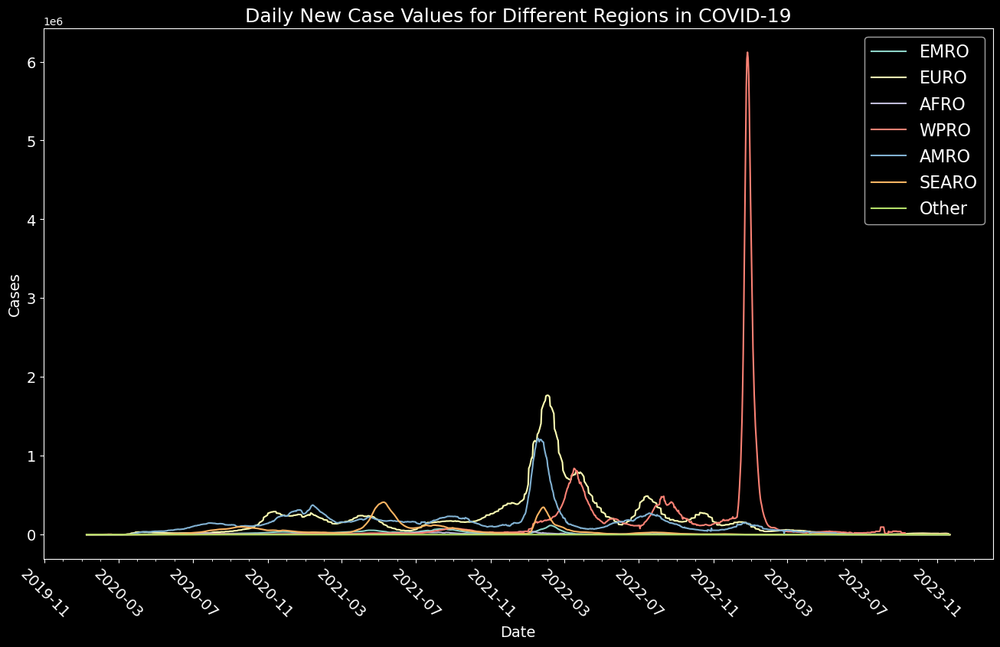

In [16]:
# Finding the sum of new cases for each day and region.
daily_new_case = {k:v.groupby("Date_reported")["New_cases"].sum().reset_index() for k,v in regions_dict.items()}

# # Commented to reduce runtime. You can uncomment to see ind. plots.
# for region in daily_new_case:
#     daily_df = daily_new_case[region]
#     plotter(df=daily_df,
#             column="New_cases",
#             main_title=region,
#             date_column="Date_reported",
#             y_title="Cases",
#             rolling=7)

# Plotting the number of new cases.
plotter(df=daily_new_case,
        column="New_cases",
        date_column="Date_reported",
        y_title="Cases",
        main_title="Daily New Case Values for Different Regions in COVID-19",
        rolling=7)

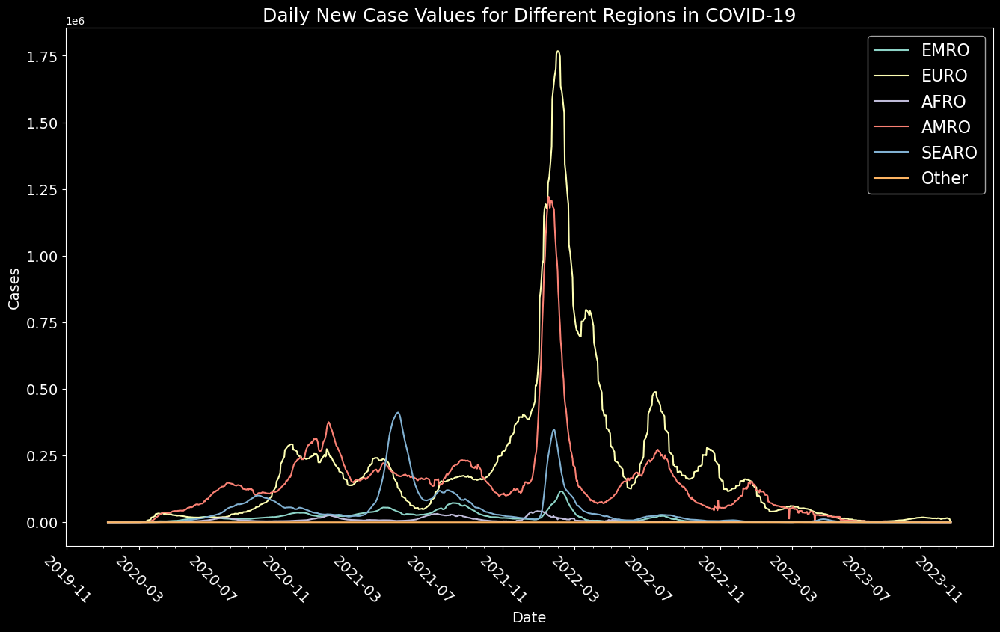

In [17]:
# We can see that the region China is in (WPRO) had a spike on 2022-12. That prevents us to see the differences in other data. That's why we filtered the data and plotted it again.
filtered_daily_new_case = {k:v for k,v in daily_new_case.items() if k != "WPRO"}

# Plotting the number of new cases again.
plotter(df=filtered_daily_new_case,
        column="New_cases",
        date_column="Date_reported",
        y_title="Cases",
        main_title="Daily New Case Values for Different Regions in COVID-19",
        rolling=7)

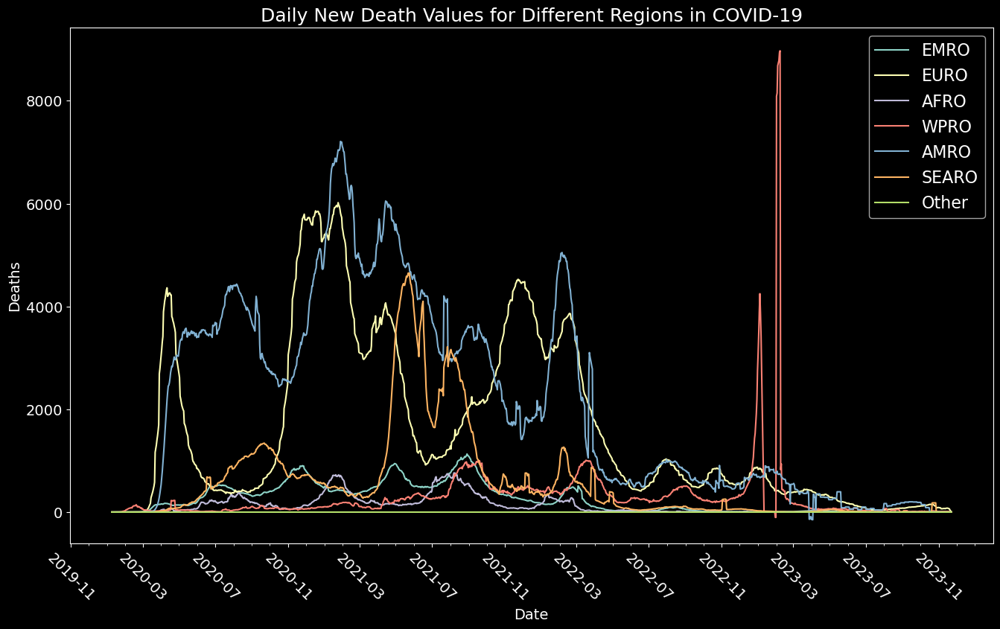

In [18]:
# Finding the sum of new deaths for each day and region.
daily_new_death = {k:v.groupby("Date_reported")["New_deaths"].sum().reset_index() for k,v in regions_dict.items()}

# Plotting the number of new deaths.
plotter(df=daily_new_death,
        column="New_deaths",
        date_column="Date_reported",
        y_title="Deaths",
        main_title="Daily New Death Values for Different Regions in COVID-19",
        rolling=7)

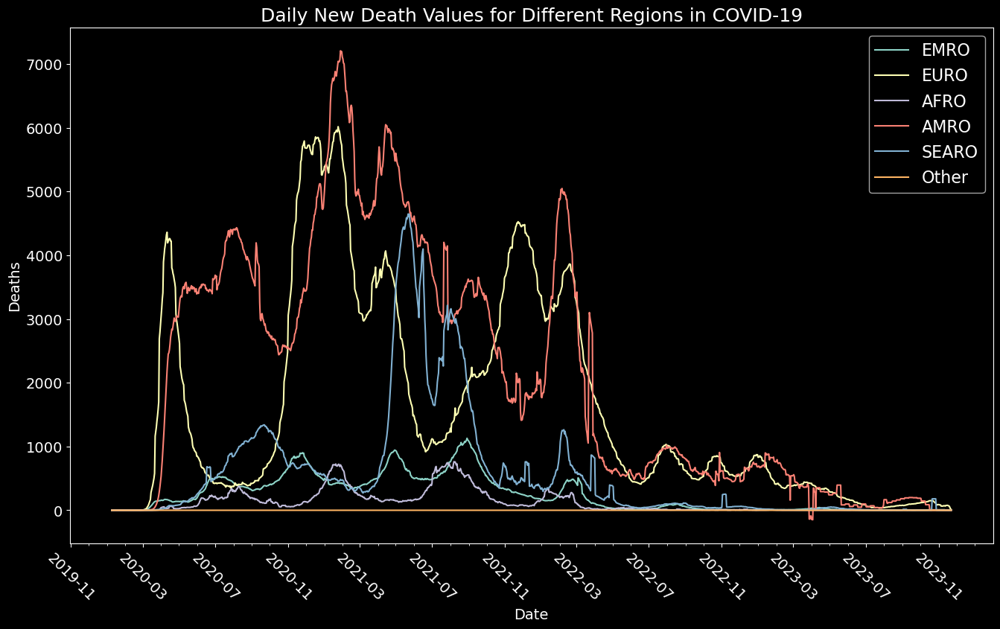

In [19]:
# We did the same thing again in this part by discarding the WPRO region. 
filtered_daily_new_death = {k:v for k,v in daily_new_death.items() if k != "WPRO"}

# Plotting the number of new deaths again.
plotter(df=filtered_daily_new_death,
        column="New_deaths",
        date_column="Date_reported",
        y_title="Deaths",
        main_title="Daily New Death Values for Different Regions in COVID-19",
        rolling=7)

## C) Adding an Animated World Graph
In the last part of our project, we decided to plot this region-based time-series data on an animated world map.
Because the dataset we're using has the country codes in ISO2 format, we first had to convert it to ISO3.
After that, we created an animated world map. When you press play, please wait patiently to see the progression in the case data. Or you can drag the slider to see the progression fast.

In [20]:
# We have to convert ISO2 codes to ISO3 in order to use them in the world map animation. 
iso2_3_dict = {code: country_converter.convert(names=[code], to="ISO3") for code in health_data.Country_code.unique()}
health_data['ISO3 Codes'] = [iso2_3_dict[val] for val in health_data['Country_code']] # Adding a new column with ISO3 codes
filtered_health_data = health_data[health_data["ISO3 Codes"] != "not found"] # Creating a new dataframe in which there are only valid ISO3 codes. 
# !!! It's normal that this cell will produce some output such as "XA not found in ISO2". Please wait patiently !!!

XA not found in ISO2
nan not found in ISO3
  not found in regex
XC not found in ISO2
XB not found in ISO2


In [21]:
# Plotting the animated world graph
fig = px.choropleth(filtered_health_data,
                    locations="ISO3 Codes",
                    color="Cumulative_cases",
                    hover_name="Country",
                    animation_frame="Date_reported",
                    color_continuous_scale=px.colors.sequential.YlGnBu,
                    title="Cumulative Case Count by Country",
                    width=1500,
                    height=800,
                    range_color=[0, filtered_health_data.Cumulative_cases.max()],)

fig.update_geos(projection_type="natural earth")

fig.show()

## D) Our Conclusions After These Results
1. Even though numerical values are different, we saw that the Virus's progression in other regions is similar to synchronous peaks. 
2. We can see that the WPRO region, which includes China, showed some extreme peaks in 12-2022. 
3. For the other regions, we can see that 02-2022 or 03-2022 are the peak months for the disease. 
4. In our world map, we noticed that without having proportional data for the case data, densely populated areas such as the USA, China, etc., dominate the world map and make it harder to see the virus's progression in less-populated regions.